# Инициализация преднастроенных нейросетевых моделей

In [1]:
from torchvision import models

alexNet = {
    # https://papers.nips.cc/paper/2012/hash/c399862d3b9d6b76c8436e924a68c45b-Abstract.html
    'model': models.alexnet(weights=models.AlexNet_Weights.DEFAULT),
    'weights': models.AlexNet_Weights.DEFAULT,
    'preprocess': models.AlexNet_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[1].in_features
}

resNet50 = {
    # https://arxiv.org/abs/1512.03385
    'model': models.resnet50(weights=models.ResNet50_Weights.DEFAULT),
    'weights': models.ResNet50_Weights.DEFAULT,
    'preprocess': models.ResNet50_Weights.DEFAULT.transforms(),
    'output_layer': 'fc',
    'in_features': lambda model: model.fc.in_features
}

denseNet = {
    # https://arxiv.org/abs/1608.06993
    'model': models.densenet201(weights=models.DenseNet201_Weights.DEFAULT),
    'weights': models.DenseNet201_Weights.DEFAULT,
    'preprocess': models.DenseNet201_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[0].in_features
}

mobileNetV3_small = {
    # https://arxiv.org/abs/1905.02244
    'model': models.mobilenet_v3_small(weights=models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT),
    'weights': models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT,
    'preprocess': models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[0].in_features
}

swinT = {
    # https://arxiv.org/abs/2103.14030
    'model': models.swin_t(weights=models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT),
    'weights': models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT,
    'preprocess': models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT.transforms(),
    'output_layer': 'head',
    'in_features': lambda model: model.head.in_features
}


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:03<00:00, 79.7MB/s]
Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 104MB/s]
Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:00<00:00, 110MB/s]
Downloading: "https://download.pytorch.org/models/mobilenet_v3_small-047dcff4.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_small-047dcff4.pth
100%|██████████| 9.83M/9.83M [00:00<00:00, 109MB/s]
Downloading: "https://download.pytorch.org/models/swin_t-704ceda3.pth" to /root/.cache/torch/hub/checkpoints/swin_t-704ceda3.pth
100%|██████████| 108M/108M [00:08<00:00, 13.7MB/s]


Далее необходимо определиться с вычислительной подсистемой (CPU или GPU).

In [2]:
import torch

gpu = 'has' if torch.cuda.is_available() else 'has no'
print(f'Current environment {gpu} GPU support')
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
!lscpu
print(f'GPU count = {torch.cuda.device_count() if torch.cuda.is_available() else "0"}')

for model in [resNet50, alexNet, denseNet, mobileNetV3_small, swinT]:
    model['model'].to(device)
    model['preprocess'].to(device)
    model['model'].eval()

Current environment has GPU support
Architecture:             x86_64
  CPU op-mode(s):         32-bit, 64-bit
  Address sizes:          46 bits physical, 48 bits virtual
  Byte Order:             Little Endian
CPU(s):                   2
  On-line CPU(s) list:    0,1
Vendor ID:                GenuineIntel
  Model name:             Intel(R) Xeon(R) CPU @ 2.00GHz
    CPU family:           6
    Model:                85
    Thread(s) per core:   2
    Core(s) per socket:   1
    Socket(s):            1
    Stepping:             3
    BogoMIPS:             4000.29
    Flags:                fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 cl
                          flush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc re
                          p_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3
                           fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand
                           hy

Вспомогательные функции

In [3]:
import os
import time
import copy
import math

import typing
from typing import Callable
from functools import partial

import numpy
import pandas
from pandas.core.arrays import boolean
import matplotlib.pyplot as plt
from requests import get

from torch import Tensor, nn
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToPILImage, Compose, Resize, CenterCrop
from torchvision.io import read_image


strip_chars = ' \t'
tmp_file_name = 'tmp_file_name_for_image_download'

to_image = ToPILImage()


def classify(dataset: Dataset,
                preprocess: typing.Callable[[Tensor],Tensor],
                num_per_row: int, single_size: float,
                labels: typing.List[str],
                model_labels: typing.List[str] = None,
                model: typing.Callable[[Tensor], Tensor] = None,
                debug: typing.Any = False,
                num_of_classes: int = 1,
                vspace: float = 0.3
             ) -> None:
    num = len(dataset)
    fig, axs = plt.subplots(math.ceil(num/num_per_row), num_per_row, figsize=(
        single_size*num_per_row, (single_size + vspace)*(math.ceil(num/num_per_row))),
        sharex=True, sharey=True)
    for i in range(0, len(dataset)):
        try:
            image, label = dataset[i]
            pred = None

            if model is not None and model_labels is not None:
                start_time = time.perf_counter_ns()
                score = model(image.unsqueeze(0)).detach().squeeze(0).softmax(0)
                pred_index = numpy.flip(score.detach().cpu().argsort().numpy())[0]
                end_time = time.perf_counter_ns()
                pred = f'Detector: {(end_time - start_time) / 1_000_000:.0f}ms\n{model_labels[pred_index]}[{score[pred_index].item()*100:.0f}%]'

            loc_fig = axs[i//num_per_row, i % num_per_row]
            loc_fig.imshow(to_image(preprocess(image)))
            title =f'\nActual: {labels[label]}[{label}]\n{pred}'
            loc_fig.title.set_text(title)
        except Exception as ex:
            if debug:
                raise ex
            print(f'Image {i} is failed to load: {str(ex)}')

    fig.subplots_adjust(wspace=0.3)
    plt.show()


def denormalize(dataset: Dataset, trans: typing.Any) -> Callable[[Tensor], Tensor]:
    image, label = dataset[0]
    std = torch.as_tensor(trans.std, dtype=image.dtype, device=image.device).view(-1, 1, 1)
    mean = torch.as_tensor(trans.mean, dtype=image.dtype, device=image.device).view(-1, 1, 1)
    return lambda img: img*std + mean


class UrlDataset(Dataset):

    def __init__(self, file: str, to_device, transform = None) -> None:
        self.file = file
        self.transform = transform
        self.dataset = pandas.read_csv(file, sep=';')
        self.classes = self.dataset['label'].unique()
        self.classes.sort()
        self.class_to_index = {self.classes[i] : i for i in range(len(self.classes))}
        self.device = to_device

    def __len__(self) -> int:
        return len(self.dataset)

    def __getitem__(self, index: int) -> typing.Tuple[torch.Tensor, str]:
        url = self.dataset.iloc[index]['url'].strip(strip_chars)
        with open(tmp_file_name, 'wb') as file:
            file.write(get(url).content)
        image = read_image(tmp_file_name).to(self.device)
        label = self.class_to_index[self.dataset.iloc[index]['label']]
        if self.transform:
            return self.transform(image), label
        return image, label


def train_model(model, dataloader: DataLoader, device: torch.device,
                critery, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = 0.0
    best_epoch = -1

    process = {'train': {'loss': [], 'accuracy': []}, 'validate': {'loss': [], 'accuracy': []}}

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)
        epoch_loss = 0.0
        epoch_acc = 0.0
        for item in dataloader:
            if item['train'] == True:
                model.train()
            else:
                model.eval()
            running_loss = 0.0
            running_corrects = 0
            dataset_size = 0
            for inputs, labels in item['loader']:
                dataset_size = dataset_size + 1
                inputs = inputs.to(device)
                labels = labels.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(item['train'] == True):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = critery(outputs, labels)
                    if item['train'] == True:
                        loss.backward()
                        optimizer.step()
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if item['train'] == True:
                scheduler.step()

            epoch_loss = running_loss / dataset_size
            epoch_acc = running_corrects.detach().cpu().double() / dataset_size

            if item['train'] == True:
                ptype = 'train'
            else:
                ptype = 'validate'

            process[ptype]['loss'].append(epoch_loss)
            process[ptype]['accuracy'].append(epoch_acc)

            print(f'[{epoch}][train={item["train"]}] Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # deep copy the model
            if item['train'] == True and 1/epoch_loss > best_loss:
                best_loss = 1/epoch_loss
                best_model_wts = copy.deepcopy(model.state_dict())
                best_epoch = epoch

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val loss: {1/best_loss:4f} at epoch {best_epoch}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, process


# Подготовка датасета для преднастроенной модели

В практическом задании набор данных (датасет) формализуется в виде CSV-файла, содержащего URL изображения из интернета и вручную назначенных меток объектов (названий классов), к которому каждое изображение относится.

In [4]:
%%writefile train.csv
label;url
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_1.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_3.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_2.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_4.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_5.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_6.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_7.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_8.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_9.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_10.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_11.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_12.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_13.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_14.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_15.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_16.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_17.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_18.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_19.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_20.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_21.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_22.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_23.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_24.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_25.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_26.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_27.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_28.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_29.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_30.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_31.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_32.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_33.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_34.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_35.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_36.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_37.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_38.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_39.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_40.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_41.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_42.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_43.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_44.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_45.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_46.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_47.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_48.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_49.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_50.jpg?raw=true

Writing train.csv


In [5]:
%%writefile test.csv
label;url
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_1.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_3.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_2.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_4.jpg?raw=true
Tractor-hydrodrill;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_5.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_26.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_27.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_28.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_29.jpg?raw=true
mobile-crane;https://github.com/Smoooky42/neural_network_coursework/blob/main/pr1_dataset/train.csv_image_30.jpg?raw=true

Writing test.csv


# Модель ResNet50
Классификация изображений с библиотечными коэффициентами

In [6]:
model = resNet50
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: ResNet
Number of parameters: 25557032


Датасет в библиогтеки PyTorch представлен базовым классом Dataset, описывающий способ загрузки и трансформации набора данных по запросу. Начнем с описания процесса "подгрузки" изображений по url и лэйблу из CSV-файла с описанием датасета.

После подготовки класса со сценарием загрузки изображений, его можно проверить путем визуализации с помощью библиотеки Matplotlib.

----------------------------------------------------------------------
Model: ResNet
Number of parameters: 25557032
------------------------------ Train dataset ------------------------------


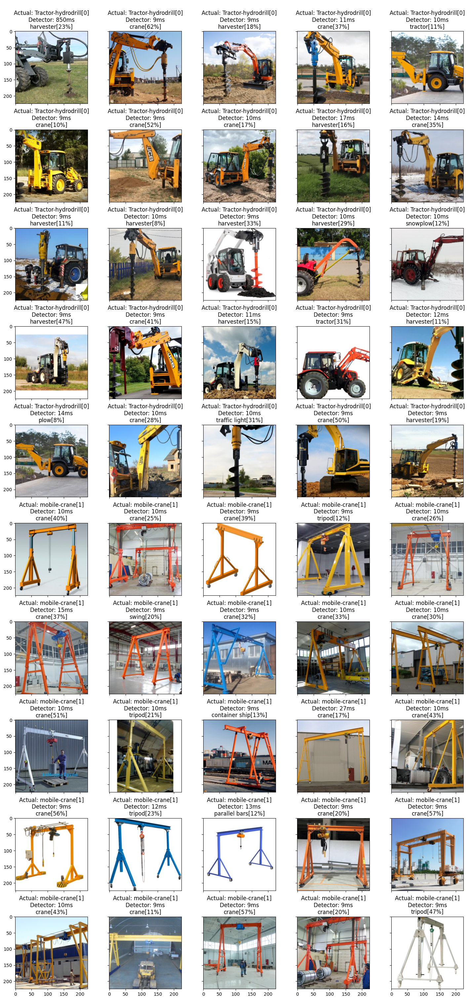

------------------------------ Test dataset ------------------------------


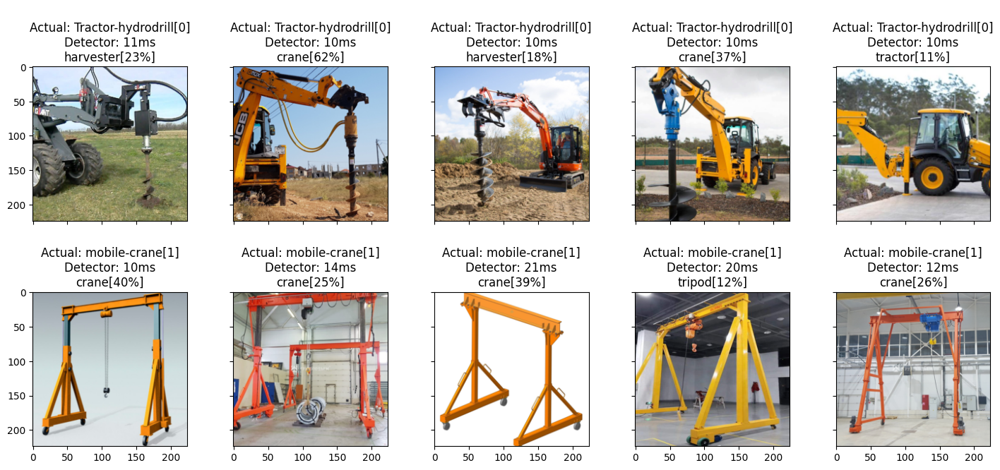

In [7]:
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)
test = UrlDataset('test.csv', device, transform)

num_per_row = 5
single_size = 3.5
vspace = 0.3

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=model['model'], model_labels=model['weights'].meta["categories"])
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=model['model'], model_labels=model['weights'].meta["categories"])

# Модель AlexNet

In [8]:
model = alexNet
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: AlexNet
Number of parameters: 61100840


----------------------------------------------------------------------
Model: AlexNet
Number of parameters: 61100840
------------------------------ Train dataset ------------------------------


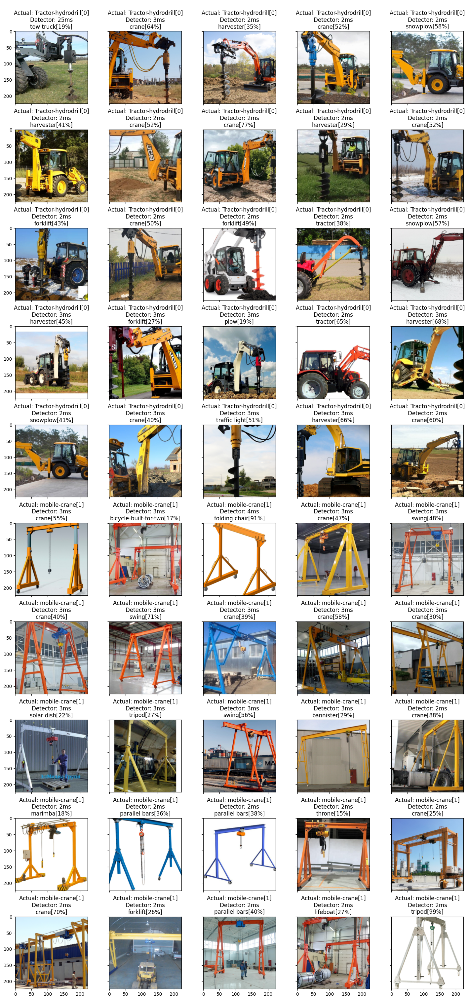

------------------------------ Test dataset ------------------------------


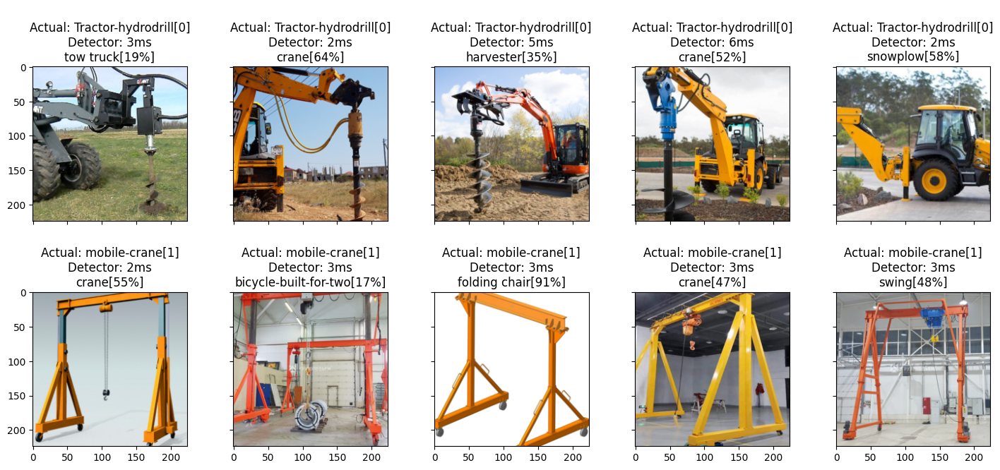

In [9]:
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)
test = UrlDataset('test.csv', device, transform)

num_per_row = 5
single_size = 3.5
vspace = 0.3

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=model['model'], model_labels=model['weights'].meta["categories"])
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=model['model'], model_labels=model['weights'].meta["categories"])

# Модель denseNet

In [10]:
model = denseNet
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: DenseNet
Number of parameters: 20013928


----------------------------------------------------------------------
Model: DenseNet
Number of parameters: 20013928
------------------------------ Train dataset ------------------------------


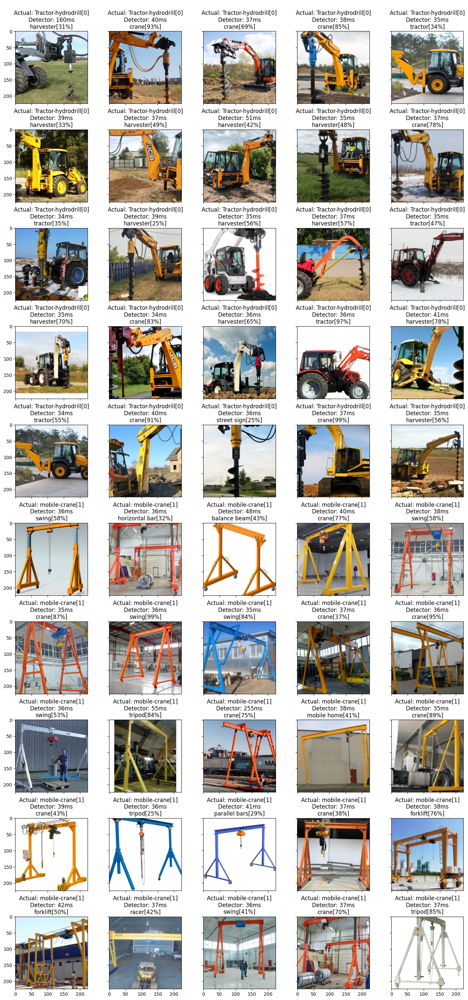

------------------------------ Test dataset ------------------------------


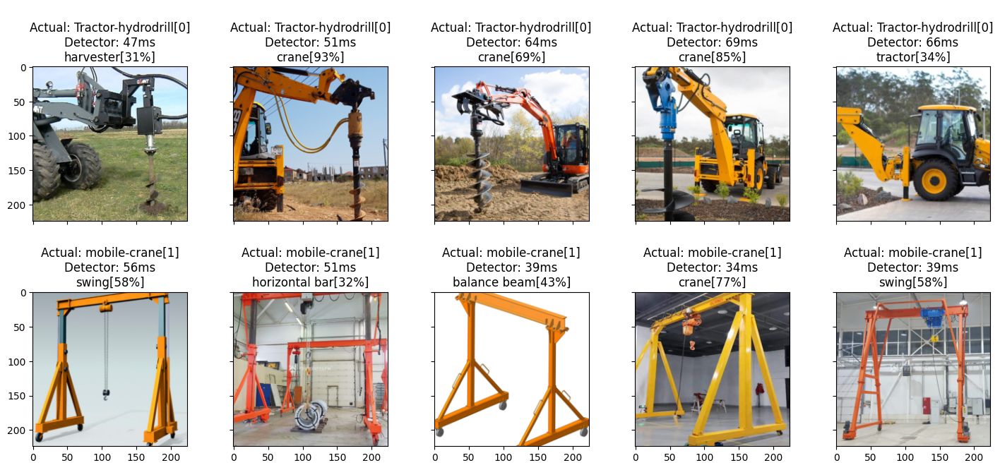

In [11]:
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)
test = UrlDataset('test.csv', device, transform)

num_per_row = 5
single_size = 3.5
vspace = 0.3

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=model['model'], model_labels=model['weights'].meta["categories"])
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=model['model'], model_labels=model['weights'].meta["categories"])

# Модель mobileNetV3_small

In [12]:
model = mobileNetV3_small
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: MobileNetV3
Number of parameters: 2542856


----------------------------------------------------------------------
Model: MobileNetV3
Number of parameters: 2542856
------------------------------ Train dataset ------------------------------


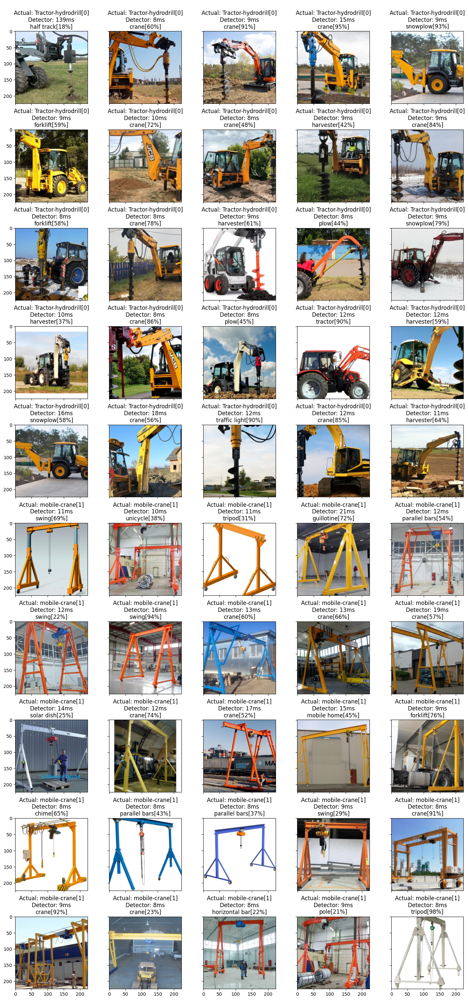

------------------------------ Test dataset ------------------------------


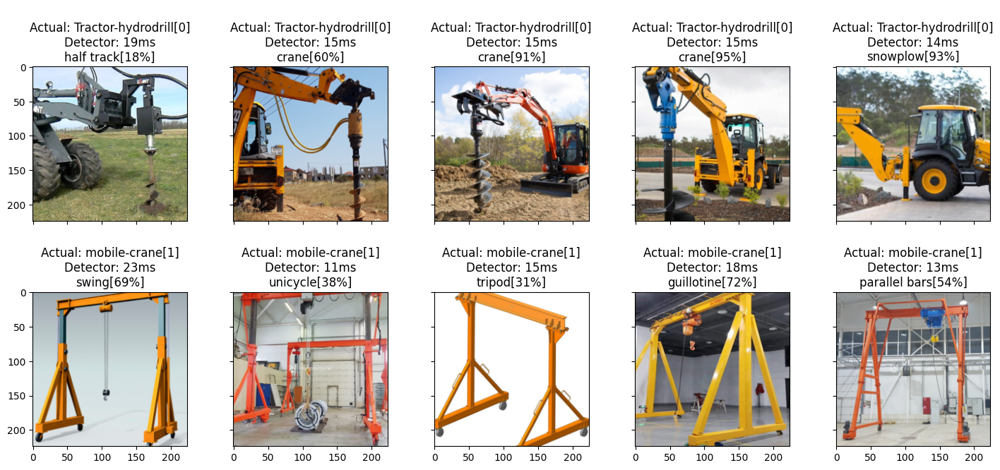

In [13]:
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)
test = UrlDataset('test.csv', device, transform)

num_per_row = 5
single_size = 3.5
vspace = 0.3

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=model['model'], model_labels=model['weights'].meta["categories"])
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=model['model'], model_labels=model['weights'].meta["categories"])

# Модель swinT

In [14]:
model = swinT
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: SwinTransformer
Number of parameters: 28288354


----------------------------------------------------------------------
Model: SwinTransformer
Number of parameters: 28288354
------------------------------ Train dataset ------------------------------


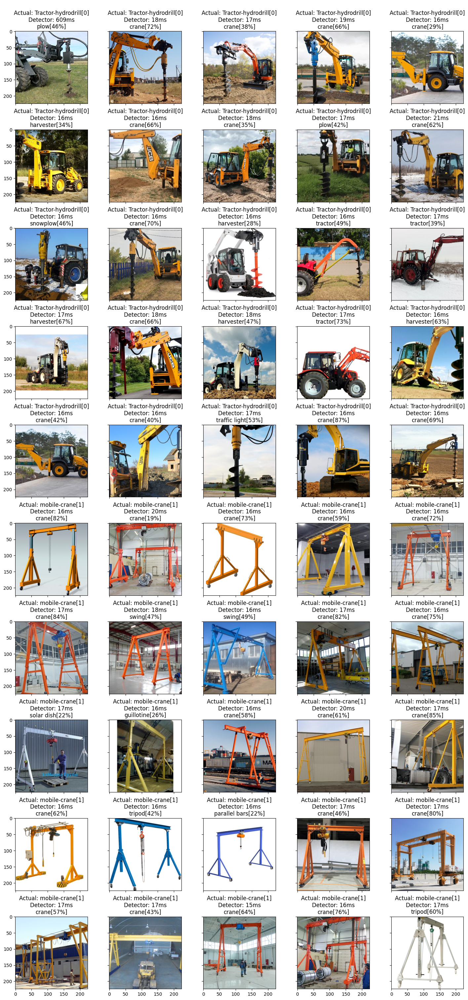

------------------------------ Test dataset ------------------------------


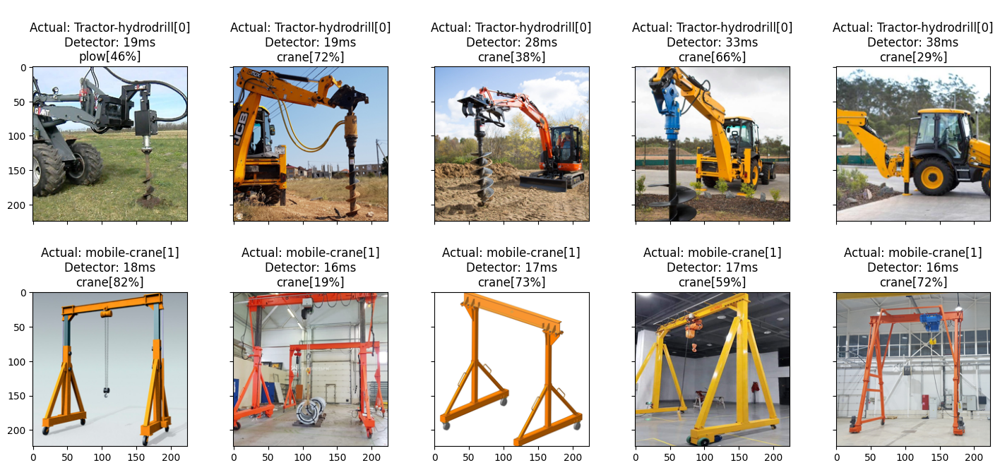

In [15]:
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)
test = UrlDataset('test.csv', device, transform)

num_per_row = 5
single_size = 3.5
vspace = 0.3

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=model['model'], model_labels=model['weights'].meta["categories"])
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=model['model'], model_labels=model['weights'].meta["categories"])

# Предобучение нейронной сети

Наиболее простой способ адаптации предобученных моделей к специфической задаче это переобучение выходного классификатора, который вычисляет принадлежность изображения к тому или иному классу. Это возможно благодаря особенности глубоких нейронных сетей, состоящей в том, что по мере преобразования между слоями происходит постепенный переход от конкретного изображения как набора пикселей к более обощённому представлению (пространство признаков), инвариантных к второстепенной информации (фон, повороты, растяжения, освещенность и т.д.). Таким образом, выходной слой лишь использует обобщённое пространство признаков для разделения на области, относящщиеся к разным классам объектов. И если цель состоит в создании иного разбиения, то достаточно заменить выходной слой на новый классификатор, настроив его на распознавание нужных классов объктов.

Популярным способом разбиения пространства признаков в случае существенно отличаюзихся классов является использование линейной гиперповерхности (линейный классификатор). Его преимуществом является простота и как следствие эффективность на небольших выборках. Основной недостаток - невозможность реализации сложных разбиений между близкими классами объектов. Для визуальной проверки возможности применения линейного классификатора в конкретной задаче можно использовать метод редукции многомерного пространства признаков, полученных на выходе предпоследнего слоя предобученной модели.

В моделях библиотеки PyTorch для этого с учетом фиксированной последовательности слоев (специфика библиотеки) необходимо отключить слой классификации, заменив его на единичное преобразование. В таком виде модель нейросети будет играть роль генератора признаков.

В первую очередь рассмотрим структуру модели и найдем в ней выходной классификатор

In [ ]:
print(model)

{'model': SwinTransformer(
  (features): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
      (1): Permute()
      (2): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
    )
    (1): Sequential(
      (0): SwinTransformerBlock(
        (norm1): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
        (attn): ShiftedWindowAttention(
          (qkv): Linear(in_features=96, out_features=288, bias=True)
          (proj): Linear(in_features=96, out_features=96, bias=True)
        )
        (stochastic_depth): StochasticDepth(p=0.0, mode=row)
        (norm2): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
        (mlp): MLP(
          (0): Linear(in_features=96, out_features=384, bias=True)
          (1): GELU(approximate='none')
          (2): Dropout(p=0.0, inplace=False)
          (3): Linear(in_features=384, out_features=96, bias=True)
          (4): Dropout(p=0.0, inplace=False)
        )
      )
      (1): SwinTransformerBloc

Выходной слой это classifier (зачастую это даже не один слой, а группа слоев, наделяющих классификатор нужными свойствами). Уберем его, чтобы получить на выходе набор признаков. Для этого заменим выходной классификатор на единичное преобразование.

In [ ]:
image, label = train[0]
feature_extractor = copy.deepcopy(model['model'])
result = feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()
print(f'Размерность выходов исходной модели: {result.shape}')
setattr(feature_extractor, model['output_layer'], nn.Identity())
result = feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()
print(f'Размерность выходов модели после замены выходного классификатора на единичное преобразование: {result.shape}')

Размерность выходов исходной модели: (1000,)
Размерность выходов модели после замены выходного классификатора на единичное преобразование: (2048,)


Попробуем визуализировать каким-либо образом пространство признаков, обозначая объекты целевых классов разными цветами. Общая гипотеза состоит в том, что изображения разных классов должны лежать в разных областях пространства признаков (т.е. они выглядят как сосредоточенные "облака" точек, которые в свою очередь расположены на значительном удвлении друг от друга). В этом случае с помощью линейной гиперплоскости можно спроецировать точки в N-мерном пространстве признаков на эту плоскость и получить одно-, двух- или трехмерные проекции этих облаков, которые уже можно визуализировать на графике. Таким образом, для проверки гипотезы достаточно убедиться, что проекции "облаков" разных классов будут визуально изолированы. В этом случае перенастройка линейного классификатора на выходе нейронной сети приведет к решению задачи классификации на индивидуальной выборке объектов.

Чтобы получить двухмерную проекцию точек пространства признаков воспользуемся методом редукции размерности на основе метода линейного PCA (Principial Component Analysis). Суть его состоит в отыскании такой линейной гиперплоскости в N-мерном пространстве, расстояние до которой всех точек будет минимальным (т.е. она максимально аппроксимирует данные). Координаты спроецированных точек в пространстве этой гиперповерхности как раз и являются искомым двухмерным представлением "облаков", характеризующих разные классы объектов выборки.

Итак, первым делом преобразуем имеющиеся списки изображений в массивы признаков и лэйблов классов.

In [ ]:
output = []
for image, label in torch.utils.data.ConcatDataset([train, test]):
    result = {'label': label, 'feature': feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()}
    output.append(result)
features = numpy.concatenate([numpy.expand_dims(record['feature'], 0) for record in output])
labels = [record['label'] for i, record in enumerate(output)]

Далее применим PCA-метод, который на основе N-мерных массивов признаков вычислит координаты точек на гиперплоскости (U), список собственных чисел (S) и собственных векторов (V) для преобразования координат между основным и редуцированным пространством.

In [ ]:
totalU, totalS, totalV = torch.pca_lowrank(torch.from_numpy(features), q=2)

Для визуализации остается совершить трансформации осей массивов, чтобы получить ряды для координат абсцис и ординат графика, а также разделить массивы точек разных классов, чтобы каждому задать свой цвет.

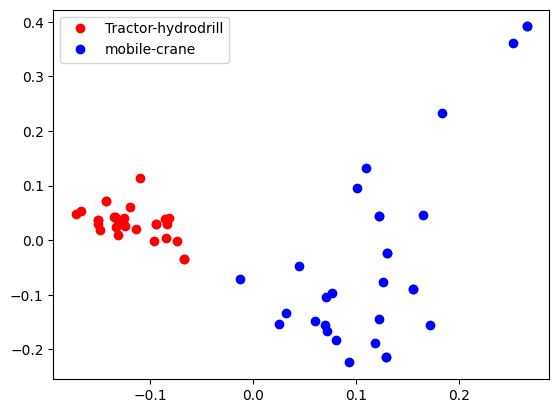

In [ ]:
series = {}
for key in ['Tractor-hydrodrill', 'mobile-crane']:
    points = numpy.concatenate([numpy.expand_dims(totalU[i,:].cpu().detach().numpy(), 0)
        for i, label in enumerate(labels) if train.classes[label] == key])
    series[key] = numpy.moveaxis(points, 1, 0)

plt.figure()
plt.plot(series['Tractor-hydrodrill'][0], series['Tractor-hydrodrill'][1], 'ro', series['mobile-crane'][0], series['mobile-crane'][1], 'bo')
plt.legend(['Tractor-hydrodrill', 'mobile-crane'])
plt.show()

На графике выше видно, что даже на двухмерной проекции точки разных классов лежат в разных областях и могут быть легко разделены прямой. Это означает, что применение линейного классификатора в данном случае выглядит оправданым.

# Донастройка модели под специфическую задачу классификации

Донастройка происходит за счет переобучения выходных слоев глубинной нейронной сети, отвечающих за различие частных деталей разных классов (https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html).

Мы будем использовать простейший классификатор - линейный, который играет роль гиперплоскости в N-мерном пространстве, разделющей пространство признаков на 2 части. Преимуществом такого классификатора является его простота, высокая скорость обучения, а также нужный результат даже при небольшом наборе данных (здесь действует эмпирическое правило: чем проще модель, тем меньше данных нужно для её обучения). Основной недостаток линейного классификатора - недостаточная сложность для случаев, когда классы визуально близки, отличаясь только нюансами. В таких ситуациях гиперплоскость является слишком простой моделью и необходимо использовать нелинейную гиперповерхность (нелинейный классификатор).

Так как мы не планируем менять коэффициенты предобученных слоев, первым делом необходимо отключить их перенастройку.

In [ ]:
tunned_model = copy.deepcopy(model['model'])
for param in tunned_model.parameters():
    param.requires_grad = False

Затем добавим новый слой-классификатор на выходе

In [ ]:
print(tunned_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
print(getattr(tunned_model, model['output_layer']))

Linear(in_features=2048, out_features=1000, bias=True)


In [ ]:
in_features = model['in_features'](tunned_model)
print(in_features)

2048


Теперь добавим линейный классификатор с нужным числом входов и двумя выходами. Выход классификатора пропустим через Softmax слой, чтобы получить на вызоде нормированный сигнал из диапазона [0;1].

In [ ]:
setattr(tunned_model, model['output_layer'], torch.nn.Sequential(torch.nn.Linear(in_features, 2), torch.nn.Softmax(dim=1)))

In [ ]:
print(tunned_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
print(f"num of adjustable parameters = {sum(i.numel() for i in getattr(tunned_model, model['output_layer']).parameters())}")

num of adjustable parameters = 4098


Для запуска процесса обучения необходим вспомогательный класс-обертка Dataloader, который позволяет объединять и разбивать наборы данных, заданные с помощью Dataset на фрагменты. Это необходимо, например, для параллелизации процесса настройки в ансамблях моделей, когда выборка разбивается на подвыборки и настройка происходит в независимых процессах.

In [ ]:
dataloader = [
    {
        'train': True,
        'loader': DataLoader(train, batch_size=1, shuffle=True, num_workers=0)
    },
    {
        'train': False,
        'loader': DataLoader(test, batch_size=1, shuffle=True, num_workers=0)
    }
]

Создадим критерий, оптимизатор и динамически изменяемый коэффициент усиления процесса обучения.

In [ ]:
tunned_model.to(device)
critery = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(getattr(tunned_model, model['output_layer']).parameters(), lr=0.001, momentum=0.9)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.5,verbose=True)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:60: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [ ]:
print(tunned_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

Наконец, проведем перенастройку

In [ ]:
model_conv, process = train_model(model=tunned_model, dataloader=dataloader, device=device,
                         critery=critery, optimizer=optimizer, scheduler=lr_scheduler,
                         num_epochs=9)

Epoch 0/8
----------
[0][train=True] Loss: 0.7004 Acc: 0.5000
[0][train=False] Loss: 0.6857 Acc: 0.7000

Epoch 1/8
----------
[1][train=True] Loss: 0.6665 Acc: 0.6200
[1][train=False] Loss: 0.6666 Acc: 0.6000

Epoch 2/8
----------
[2][train=True] Loss: 0.6447 Acc: 0.8600
[2][train=False] Loss: 0.7022 Acc: 0.7000

Epoch 3/8
----------
[3][train=True] Loss: 0.6164 Acc: 0.9600
[3][train=False] Loss: 0.6399 Acc: 0.8000

Epoch 4/8
----------
[4][train=True] Loss: 0.5901 Acc: 0.9800
[4][train=False] Loss: 0.6368 Acc: 0.9000

Epoch 5/8
----------
[5][train=True] Loss: 0.5692 Acc: 1.0000
[5][train=False] Loss: 0.6286 Acc: 1.0000

Epoch 6/8
----------
[6][train=True] Loss: 0.5615 Acc: 1.0000
[6][train=False] Loss: 0.5987 Acc: 1.0000

Epoch 7/8
----------
[7][train=True] Loss: 0.5512 Acc: 1.0000
[7][train=False] Loss: 0.6154 Acc: 0.9000

Epoch 8/8
----------
[8][train=True] Loss: 0.5454 Acc: 1.0000
[8][train=False] Loss: 0.6104 Acc: 0.8000

Training complete in 5m 45s
Best val loss: 0.545430 at 

Text(0, 0.5, 'Значение ошибки')

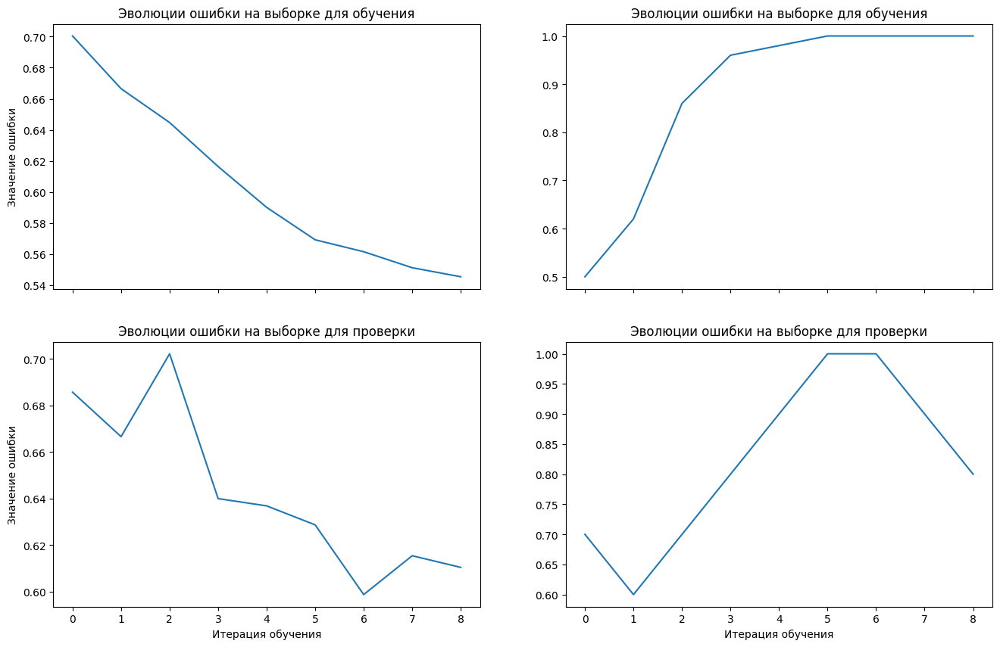

In [ ]:
fig, axs = plt.subplots(2,2, figsize=(16,10), sharex=True)
axs[0,0].plot(process['train']['loss'])
axs[0,0].title.set_text('Эволюции ошибки на выборке для обучения')
axs[0,1].plot(process['train']['accuracy'])
axs[0,1].title.set_text('Эволюции ошибки на выборке для обучения')
axs[1,0].plot(process['validate']['loss'])
axs[1,0].title.set_text('Эволюции ошибки на выборке для проверки')
axs[1,1].plot(process['validate']['accuracy'])
axs[1,1].title.set_text('Эволюции ошибки на выборке для проверки')
axs[1,0].set_xlabel('Итерация обучения')
axs[1,1].set_xlabel('Итерация обучения')
axs[0,0].set_ylabel('Значение ошибки')
axs[1,0].set_ylabel('Значение ошибки')

Выведем результат после обучения

------------------------------ Train dataset ------------------------------


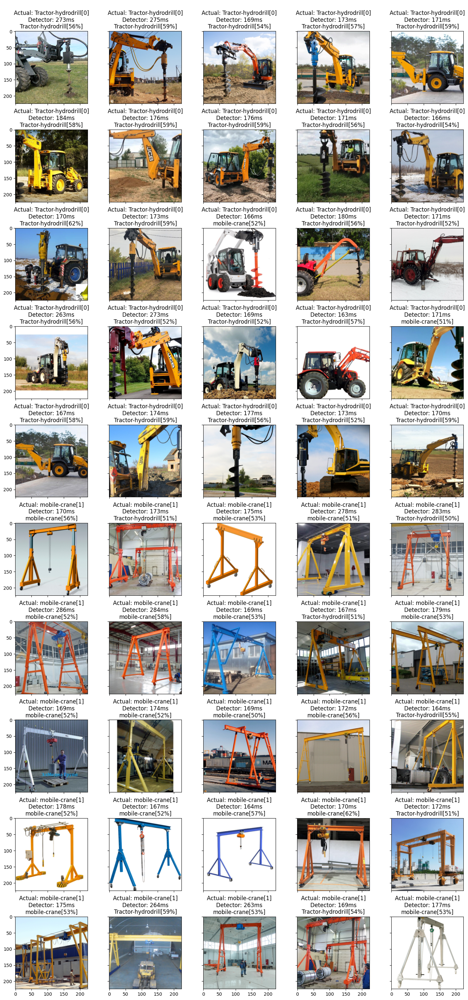

------------------------------ Test dataset ------------------------------


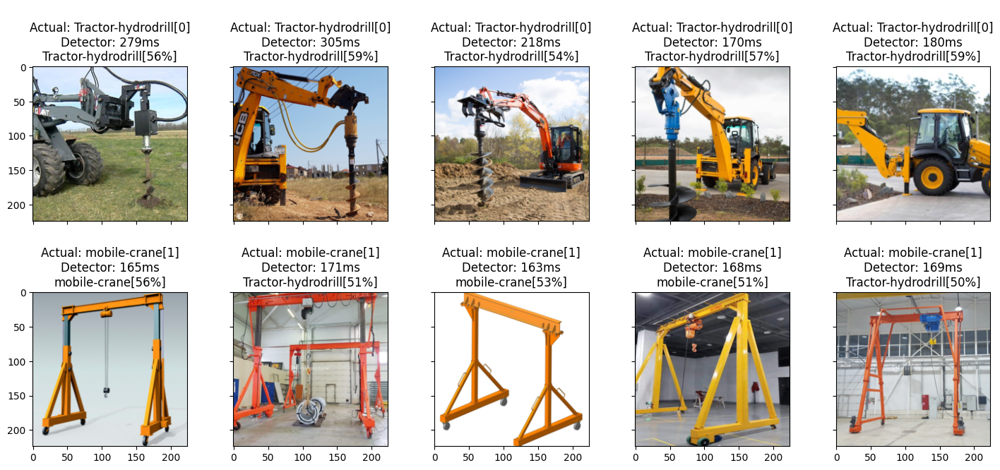

In [ ]:
print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=tunned_model, model_labels=train.classes, debug=True  )
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=tunned_model, model_labels=test.classes)